In [1]:
import gymnasium as gym
import aero_gym
from aero_gym.tools import evaluate, plotfile, animaterender, animaterender_contour
import matplotlib
import math
import numpy as np
from gymnasium.utils.env_checker import check_env
from gymnasium.wrappers import FrameStack, FlattenObservation
from pathlib import Path
import importlib.resources
import time
import os

In [2]:
import sys
sys.path.append('../aero_gym_SB3/')
import trajectory_generators

In [3]:
matplotlib.rcParams["animation.html"] = "jshtml"

In [4]:
tmp_dir = '/u/home/b/beckers/project-sofia/tmp_dir/'

In [5]:
t_max = 10
delta_t = 0.1
t = np.linspace(0, t_max, int(t_max/delta_t)+1)

## No h_ddot

In [6]:
env = gym.make(
    'aero_gym/viscous_flow-v0',
    render_mode="grid",
    t_max=t_max,
    delta_t=delta_t,
    Re=200,
    gridRe=4,
    observe_vorticity_field=True,
    observe_previous_lift=True,
    observe_previous_pressure=True,
    pressure_sensor_positions=[-0.3,-0.2,-0.1,0.0,0.1,0.2,0.3],
    h_ddot_scale=1,
    alpha_ddot_scale=1,
    vorticity_scale=10.0
)

`lift_upper_limit` and/or `lift_lower_limit` not provided, setting limits to plus and minus `lift_scale`


/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


nt_opt = 12
nt_opt = 12
nt_opt = 12
Flow solver timestep: delta_t = 0.01
Setting environment timestep to multiple of flow solver timestep: delta_t = 0.1


In [7]:
tic = time.perf_counter()
obs, info, render_list = evaluate(env, tmp_dir + 'testlog_no_hddot.txt')
toc = time.perf_counter()
print(f"{toc - tic:0.4f} seconds")

No h_ddot provided, using zeros instead
No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 0  0      0 82664480 500192 101815632    0    0     0    34    1    0  5  5 90  0  0
nt_opt = 12
31.8167 seconds


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


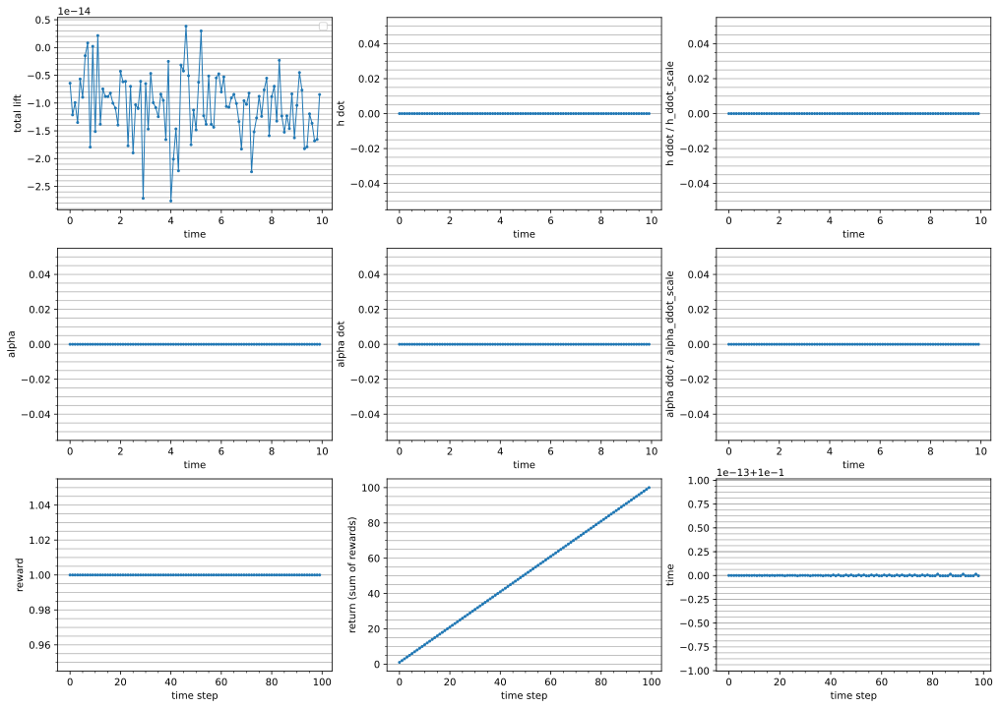

In [8]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_no_hddot.txt')

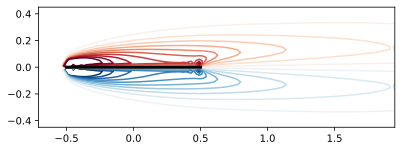

In [9]:
xg, yg = env.jl.eval("xg, yg = coordinates(vorticity(integrator),g)")
pivot_idx = (env.a, 0)
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender_contour(tmp_dir + 'testlog_no_hddot.txt', xg, yg, render_list, pivot_idx);
anim

## Impulse

In [10]:
env.reset(options={"h_ddot_prescribed":None,"h_ddot_generator":trajectory_generators.impulse(1.0)});

No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 1  0      0 82286080 500208 101817272    0    0     0    34    0    0  5  4 90  0  0
nt_opt = 12


/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


In [11]:
obs, info, render_list = evaluate(env, tmp_dir + 'testlog_impulse.txt')

No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 0  0      0 82273712 500208 101817264    0    0     0    34    0    0  5  4 90  0  0
nt_opt = 12


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


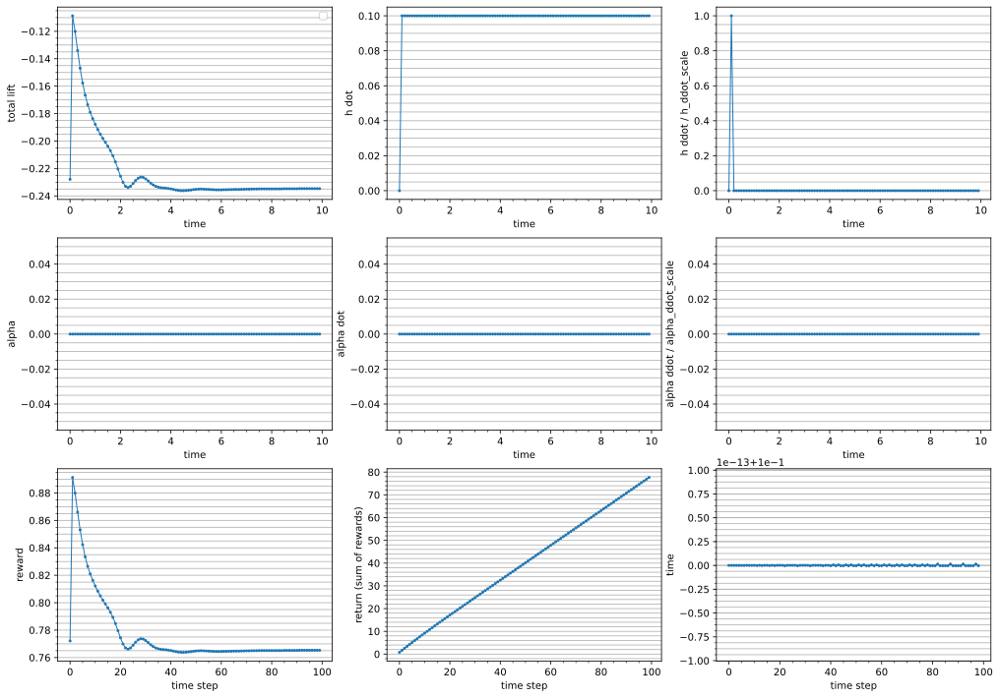

In [12]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_impulse.txt')

/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


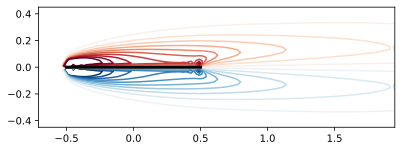

In [15]:
xg, yg = env.jl.eval("xg, yg = coordinates(vorticity(integrator),g)")
pivot_idx = (env.a, 0)
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender_contour(tmp_dir + 'testlog_impulse.txt', xg, yg, render_list, pivot_idx, animate_every=2);
anim

## Step

In [16]:
env.reset(options={"h_ddot_prescribed":None,"h_ddot_generator":trajectory_generators.constant(0.1)});

No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 1  0      0 81918896 500244 101814584    0    0     0    34    0    0  5  4 90  0  0
nt_opt = 12


/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


In [17]:
obs, info, render_list = evaluate(env, tmp_dir + 'testlog_ones.txt')

No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 0  0      0 81914432 500244 101814592    0    0     0    34    0    0  5  4 90  0  0
nt_opt = 12


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


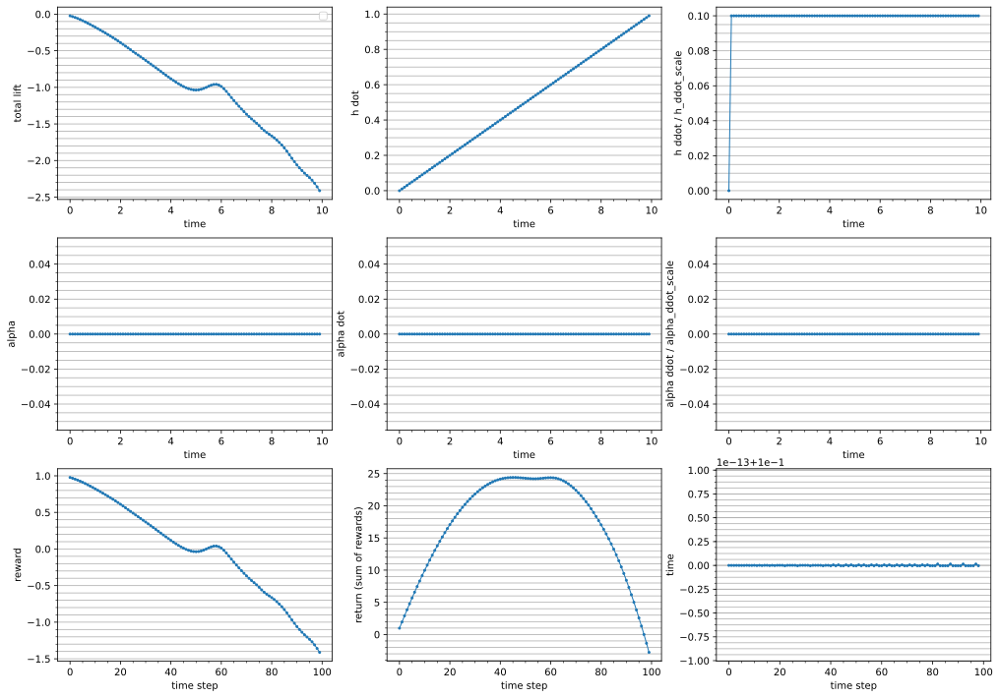

In [18]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_ones.txt')

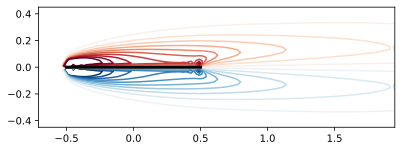

In [19]:
xg, yg = env.jl.eval("xg, yg = coordinates(vorticity(integrator),g)")
pivot_idx = (env.a, 0)
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender_contour(tmp_dir + 'testlog_ones.txt', xg, yg, render_list, pivot_idx, animate_every=2);
anim

## Gaussian

In [24]:
def gaussian(x, a, b, c):
    return a * math.exp(-(x - b) ** 2 / (2 * c ** 2))

def dgaussian(x, a, b, c):
    return a * -(x - b) / c ** 2 * math.exp(-(x - b) ** 2 / (2 * c ** 2))

def ddgaussian(x, a, b, c):
    return a * (x ** 2 + b ** 2 - 2 * b * x - c ** 2) / c ** 4 * math.exp(-(x - b) ** 2 / (2 * c ** 2))

In [25]:
a = -2/3
b = 3.0
c = 0.4
h_ddot_dgaussian = [0.25 * dgaussian(ti, a, b, c) for ti in t]

a = 1/6
b = 8.0
c = 0.4
alpha_ddot_dgaussian = [ddgaussian(ti, a, b, c) for ti in t]

In [26]:
env.reset(options={"h_ddot_prescribed":h_ddot_dgaussian});

No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 3  0      0 81505792 500260 101820880    0    0     0    34    0    1  5  4 90  0  0
nt_opt = 12


/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


In [27]:
obs, info, render_list = evaluate(env, tmp_dir + 'testlog_gaussian.txt', alpha_ddot_prescribed=alpha_ddot_dgaussian)

No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 1  0      0 81505048 500260 101820880    0    0     0    34    0    1  5  4 90  0  0
nt_opt = 12


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


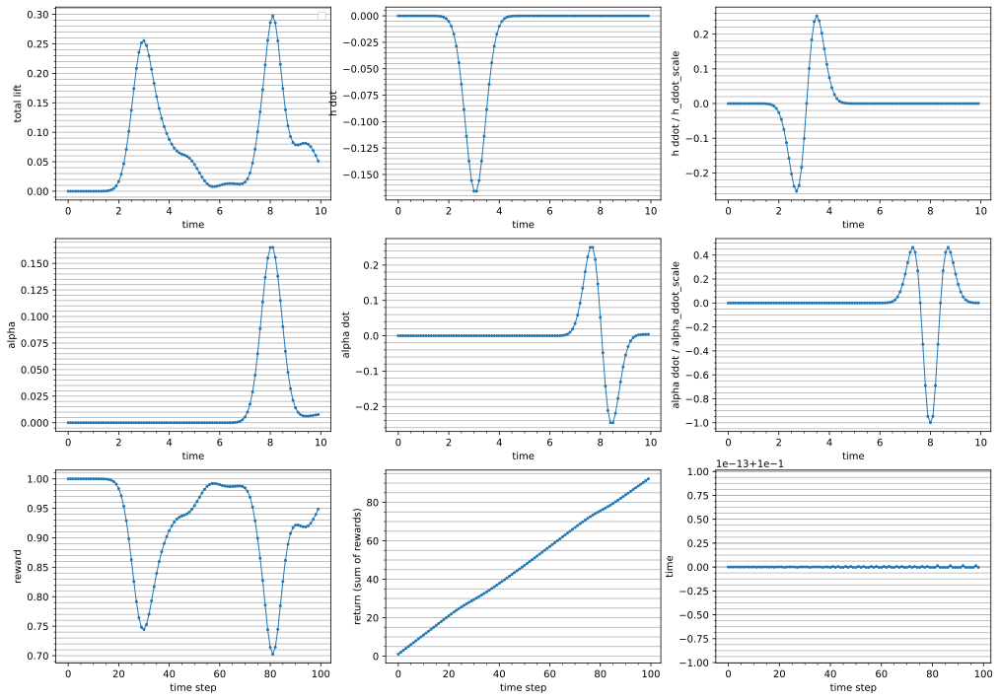

In [28]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_gaussian.txt')

/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


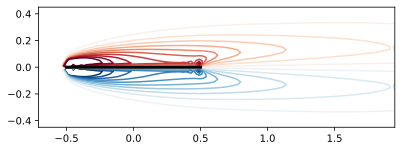

In [31]:
xg, yg = env.jl.eval("xg, yg = coordinates(vorticity(integrator),g)")
pivot_idx = (env.a, 0)
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender_contour(tmp_dir + 'testlog_gaussian.txt', xg, yg, render_list, pivot_idx, animate_every=2);
anim

## Random steps/ramps

In [32]:
env_random_steps_ramps = gym.make(
    'aero_gym/viscous_flow-v0',
    render_mode="grayscale_array",
    t_max=t_max,
    delta_t=delta_t,
    observe_vorticity_field=False,
    observe_previous_lift=True,
    observe_previous_pressure=True,
    pressure_sensor_positions=[-0.3,-0.2,-0.1,0.0,0.1,0.2,0.3],
    h_ddot_scale=1,
    alpha_ddot_scale=0.1,
    vorticity_scale=10.0,
    lift_scale=1.0,
    h_ddot_generator=trajectory_generators.random_d_ramps(max_int_amplitude=1.0, max_d_amplitude=1.0)
)

`lift_upper_limit` and/or `lift_lower_limit` not provided, setting limits to plus and minus `lift_scale`
nt_opt = 12
nt_opt = 12
nt_opt = 12


/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


Flow solver timestep: delta_t = 0.01
Setting environment timestep to multiple of flow solver timestep: delta_t = 0.1


In [33]:
obs, info = env_random_steps_ramps.reset()

No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 0  0      0 80933072 500296 101821952    0    0     0    34    0    1  5  4 90  0  0


/u/home/b/beckers/unsteady_aero_RL/notebooks/../aero_gym_SB3/trajectory_generators.py:111: RuntimeWarning: divide by zero encountered in scalar divide
  increment = event_value / (end_index -  start_index)


nt_opt = 12


In [34]:
obs, info, render_list = evaluate(env_random_steps_ramps, tmp_dir + 'testlog_random.txt')

No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 0  0      0 80928016 500296 101821944    0    0     0    34    0    1  5  4 90  0  0
nt_opt = 12


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


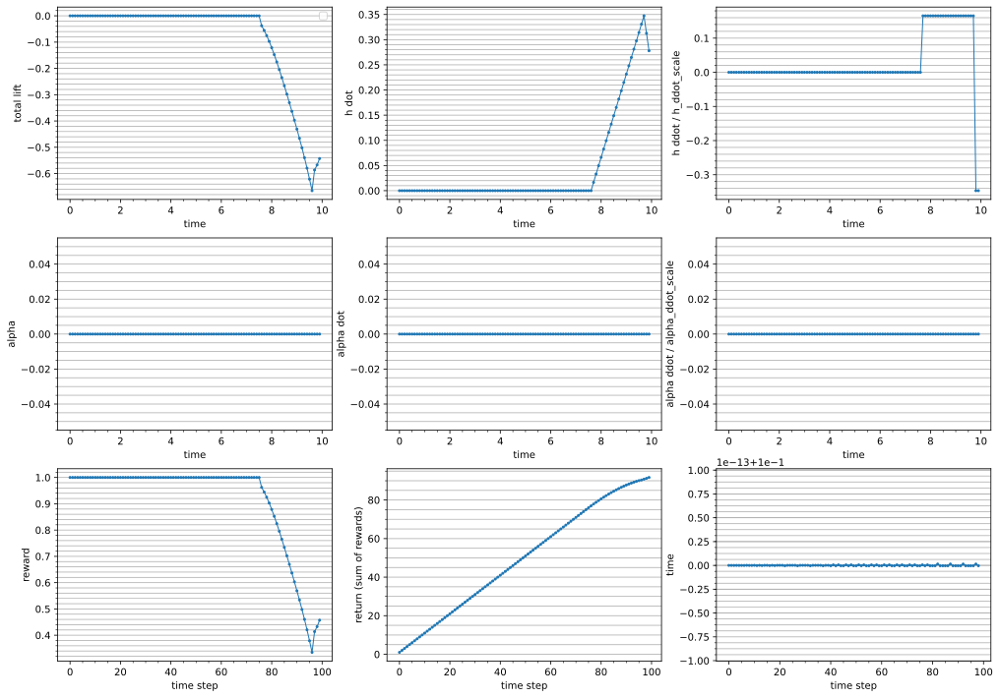

In [35]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_random.txt')

## Point forcing

In [6]:
env_forcing = gym.make(
    'aero_gym/viscous_flow-v0',
    render_mode="grid",
    t_max=3.0,
    delta_t=0.03,
    observe_vorticity_field=True,
    observe_previous_lift=True,
    observe_previous_lift_error=True,
    alpha_ddot_scale=8.0,
    lift_scale=0.1,
    lift_upper_limit=0.6,
    lift_lower_limit=-0.6,
    lift_termination=True,
    vorticity_scale=10,
    xlim=[-1,1.75],
    ylim=[-0.5,0.5],
    sys_reinit_commands_file='../aero_gym_SB3/julia_system_with_forcing.jl'
)

/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


nt_opt = 12
nt_opt = 12
nt_opt = 12
Flow solver timestep: delta_t = 0.01
Setting environment timestep to multiple of flow solver timestep: delta_t = 0.03


In [7]:
tic = time.perf_counter()
obs, info, render_list = evaluate(env_forcing, tmp_dir + 'testlog_forcing.txt')
toc = time.perf_counter()
print(f"{toc - tic:0.4f} seconds")

No h_ddot provided, using zeros instead
No reference lift provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 1  0      0 82607840 500436 101821536    0    0     0    34    0    0  5  4 91  0  0
nt_opt = 12
amp = 1
nt_opt = 12
nt_opt = 12
nt_opt = 12
25.3072 seconds


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


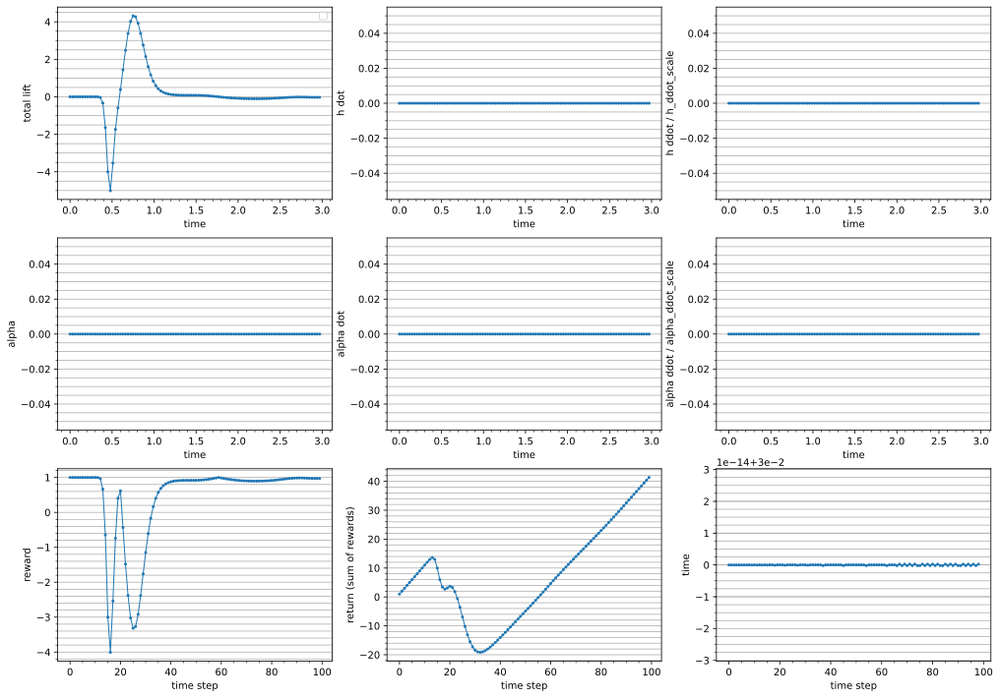

In [8]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_forcing.txt')

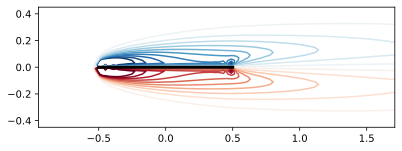

In [9]:
xg, yg = env_forcing.jl.eval("xg, yg = coordinates(vorticity(integrator),g)")
pivot_idx = (env_forcing.a, 0)
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender_contour(tmp_dir + 'testlog_forcing.txt', xg, yg, render_list, pivot_idx, animate_every=2);
anim

## Reference lift

In [10]:
t_max_ref = 20
delta_t = 0.1
t_ref = np.linspace(0, t_max_ref, int(t_max_ref/delta_t)+1)

In [11]:
alpha_ddot_scale = 10.0
alpha = 25 * np.pi / 180
T = alpha / (alpha_ddot_scale * delta_t)
alpha_ddot_for_constant_nonzero_alpha = np.zeros(len(t_ref))
alpha_ddot_for_constant_nonzero_alpha[0] = 1
alpha_ddot_for_constant_nonzero_alpha[int(T / delta_t)] = -1

In [22]:
env_ref = gym.make(
    'aero_gym/viscous_flow-v0',
    render_mode="grid",
    t_max=t_max_ref,
    delta_t=delta_t,
    observe_vorticity_field=True,
    observe_previous_lift=True,
    observe_previous_lift_error=True,
    h_ddot_scale=0.1,
    alpha_ddot_scale=alpha_ddot_scale,
    reference_lift_generator=trajectory_generators.constant(0.5),
    lift_scale=1,
    lift_upper_limit=1.0,
    lift_lower_limit=-1.0,
    lift_termination=True,
    vorticity_scale=10,
    ylim=[-0.55,0.85]
)

nt_opt = 12
nt_opt = 12
nt_opt = 12
Flow solver timestep: delta_t = 0.01
Setting environment timestep to multiple of flow solver timestep: delta_t = 0.1


In [23]:
obs, info, render_list = evaluate(env_ref, tmp_dir + 'testlog_reference_lift.txt', alpha_ddot_prescribed = alpha_ddot_for_constant_nonzero_alpha)

No h_ddot provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
 0  0      0 80916808 500480 101824928    0    0     0    34    1    1  5  4 91  0  0
nt_opt = 12


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


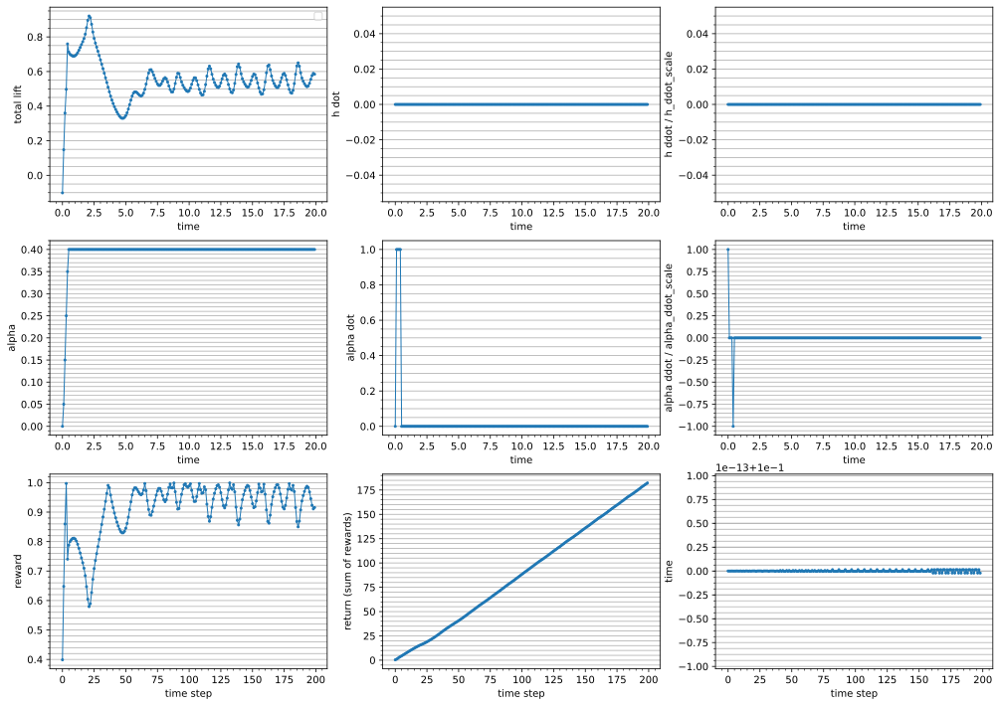

In [24]:
%config InlineBackend.figure_format = 'svg'
fig, axarr = plotfile(tmp_dir + 'testlog_reference_lift.txt')

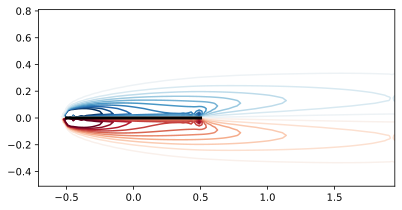

In [25]:
xg, yg = env_ref.jl.eval("xg, yg = coordinates(vorticity(integrator),g)")
pivot_idx = (env_ref.a, 0)
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender_contour(tmp_dir + 'testlog_reference_lift.txt', xg, yg, render_list, pivot_idx, animate_every=2);
anim

## Vortex shedding

In [26]:
env_vks = gym.make(
    'aero_gym/viscous_flow-v0',
    render_mode="grid",
    t_max=10,
    delta_t=delta_t,
    observe_vorticity_field=True,
    observe_previous_lift=True,
    observe_previous_lift_error=True,
    h_ddot_scale=0.1,
    alpha_ddot_scale=10,
    reference_lift_generator=trajectory_generators.constant(0.7),
    lift_scale=1,
    lift_upper_limit=1.0,
    lift_lower_limit=-0.1,
    lift_termination=True,
    vorticity_scale=10,
    ylim=[-0.55,0.85],
    alpha_init=0.52356,
    initialization_time=10
)

/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


nt_opt = 12
nt_opt = 12
Flow solver timestep: delta_t = 0.01nt_opt = 12

Setting environment timestep to multiple of flow solver timestep: delta_t = 0.1


In [27]:
tic = time.perf_counter()
obs, info, render_list = evaluate(env_vks, tmp_dir + 'testlog_vks.txt')
toc = time.perf_counter()
print(f"{toc - tic:0.4f} seconds")

No h_ddot provided, using zeros instead
procs -----------memory---------- ---swap-- -----io---- -system-- ------cpu-----
 r  b   swpd   free   buff  cache   si   so    bi    bo   in   cs us sy id wa st
26  0      0 79690920 500508 101824616    0    0     0    34    1    1  5  4 91  0  0
nt_opt = 12
43.0691 seconds


/u/home/b/beckers/unsteady_aero_RL/gymnasium_28/env_gymnasium_28/lib/python3.9/site-packages/julia/core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


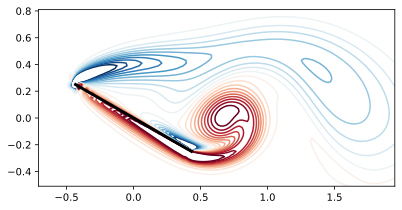

In [30]:
xg, yg = env_vks.jl.eval("xg, yg = coordinates(vorticity(integrator),g)")
pivot_idx = (env_vks.a, 0)
matplotlib.rcParams['image.interpolation'] = 'none'
anim = animaterender_contour(tmp_dir + 'testlog_vks.txt', xg, yg, render_list, pivot_idx, animate_every=2, alpha_init=env_vks.alpha_init);
anim